<a href="https://colab.research.google.com/github/ThanuMahee12/ayush-vision/blob/res-net/Algorithums/pretrained/ResNet50/ResNetFinal.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ResNet 50

In [1]:
from google.colab import drive

In [2]:
drive.mount('/content/drive') # drive activate for Use

Mounted at /content/drive


In [ ]:
!pip install firebase-admin

## Imports

### Collab Imports

In [4]:
firebase_count=1

### Default Nessary Imports

In [5]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
from datetime import date,datetime
import json
import csv

### Tensorflow Imports

In [6]:
import tensorflow as tf
from tensorflow.keras.utils import image_dataset_from_directory
from tensorflow.keras.preprocessing import image
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Sequential,load_model
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense,Conv2D, MaxPooling2D, Flatten,GlobalAveragePooling2D,Dropout,Layer
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
import firebase_admin
from firebase_admin import credentials,storage
from firebase_admin import firestore

## Variables

### Path variables

In [7]:
dataset_dir='/content/drive/MyDrive/AYUSHVISION/preTrained/final' #datasetbase dirctory

In [9]:
epochs=100

In [10]:
document_id=f'{datetime.now().strftime("%Y_%m_%d_%H")}_{epochs}'
storageLocation=f'training/res_net/'

In [11]:
working_dir=f'/content/drive/MyDrive/AYUSHVISION/ready/{document_id}'

In [12]:
dataset_train_dir=os.path.join(dataset_dir,'train')
dataset_test_dir=os.path.join(dataset_dir,'test')
dataset_val_dir=os.path.join(dataset_dir,'val')

### Genrator Variable

In [13]:
rescale=1/255

### Configration Variables

In [14]:
target_size=(224,224)
class_mode='categorical'
input_shape=(224,224,3)

### Model Variables

#### Number If Classes

In [15]:
no_of_classes=32

## Envirumentatl Setup

### Collab

## Firebase

In [16]:

if firebase_count==1:
  cred = credentials.Certificate("/content/drive/MyDrive/ServiceKey.json")
  firebase_admin.initialize_app(cred,{
    'storageBucket': 'ayush-vision-asw4gh.appspot.com'
})
firebase_count=firebase_count+1

In [17]:
db = firestore.client()

In [18]:
bucket = storage.bucket()

In [19]:
dcnn_ref = db.collection("training1").document('res-net')
doc = dcnn_ref.get()

In [20]:
if not doc.exists:
  doc_ref= db.collection("training1").document('res-net')
  doc_ref.set({'algorithum':'res-net','version':'1','mode':'classification','url':'res-net'})
else:
  doc_ref= dcnn_ref

## Validations

In [21]:
f'{dataset_train_dir} is Correct' if os.path.exists(dataset_train_dir) and os.path.isdir(dataset_train_dir) else f' {dataset_train_dir} is incorrect'


'/content/drive/MyDrive/AYUSHVISION/preTrained/final/train is Correct'

In [22]:
f'{dataset_test_dir} is Correct' if os.path.exists(dataset_test_dir) and os.path.isdir(dataset_train_dir) else f' {dataset_test_dir} is incorrect'


'/content/drive/MyDrive/AYUSHVISION/preTrained/final/test is Correct'

In [23]:
f'{dataset_val_dir} is Correct' if os.path.exists(dataset_val_dir) and os.path.isdir(dataset_val_dir) else f' {dataset_val_dir} is incorrect'

'/content/drive/MyDrive/AYUSHVISION/preTrained/final/val is Correct'

In [24]:
if not os.path.exists(working_dir):
  os.makedirs(working_dir)

## DataSet

### Image Genarator

In [26]:
train_data_genrator=image.ImageDataGenerator(
    rescale=1.0/255,
    rotation_range=40,          # Randomly rotate images up to 40 degrees
    width_shift_range=0.2,      # Shift images horizontally up to 20% of total width
    height_shift_range=0.2,     # Shift images vertically up to 20% of total height
    shear_range=0.2,            # Shear transformations (distortion along axes)
    zoom_range=0.2,             # Randomly zoom in or out
    horizontal_flip=True,       # Flip images horizontally
)

In [28]:
test_data_genrator=image.ImageDataGenerator(    rescale=1.0/255,            # Normalize pixel values to [0, 1]
    rotation_range=40,          # Randomly rotate images up to 40 degrees
    shear_range=0.2,            # Shear transformations (distortion along axes)
    zoom_range=0.2,             # Randomly zoom in or out
    horizontal_flip=True,       # Flip images horizontally
)

In [29]:
val_data_genrator=image.ImageDataGenerator(
    rescale=1.0/255,           # Normalize pixel values to [0, 1]
    rotation_range=40,          # Randomly rotate images up to 40 degrees

    zoom_range=0.2,             # Randomly zoom in or out
    horizontal_flip=True,       # Flip images horizontally

)

In [30]:
train_ds_gen=train_data_genrator.flow_from_directory(
    dataset_train_dir,
    target_size=(224,224),
    class_mode=class_mode
)

Found 11174 images belonging to 32 classes.


In [31]:
val_ds_gen=val_data_genrator.flow_from_directory(
    dataset_val_dir,
    target_size=target_size,
    class_mode=class_mode
)

Found 1598 images belonging to 32 classes.


In [32]:
test_ds_gen=test_data_genrator.flow_from_directory(
    dataset_test_dir,
    target_size=target_size,
    class_mode=class_mode
)

Found 3197 images belonging to 32 classes.


## Model


In [33]:
basicdata={'account':'vediothanu@gmail.com','user':"Thanush"}

In [34]:
basicdata['imageSize']=[224,224]
basicdata['project']=working_dir
basicdata['name']=document_id
basicdata['training_date']=datetime.now().strftime("%Y/%m/%d %H:%M:%S")
basicdata['filename']='ResNetFinal'


In [35]:
basicdata['names']=os.listdir(os.path.join(dataset_dir,'train'))

In [36]:
today_ref=doc_ref.collection("Pretrained").document(document_id)

In [37]:
today_ref.set(basicdata)

update_time {
  seconds: 1726108512
  nanos: 495424000
}

### Base Model MobileNetV3

In [38]:
ayush_resnet_50=ResNet50(input_shape=input_shape,  # We don't want the dense layers on top
                       input_tensor=None,
                        include_top=False,
                        weights='imagenet')

16705208/16705208 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step


### Layers setup for Base Model

In [39]:
for layer in ayush_resnet_50.layers:
    layer.trainable = True

### Final Model

In [40]:
ayushVision_ResNet50_Model=Sequential()


In [41]:
ayushVision_ResNet50_Model.add(ayush_resnet_50)

#### Middle Layers

In [42]:
ayushVision_ResNet50_Model.add(GlobalAveragePooling2D())

In [43]:
ayushVision_ResNet50_Model.add(Dense(320, activation='relu'))

In [44]:
ayushVision_ResNet50_Model.add(Dropout(0.2))

In [45]:
ayushVision_ResNet50_Model.add(Dense(320, activation='relu'))

#### Last Layer

In [46]:
ayushVision_ResNet50_Model.add(Dense(no_of_classes, activation='softmax'))

In [47]:
today_training_colref=today_ref.collection('Train')

## Model Compile

#### Optimizer

In [48]:
optimizer = Adam(learning_rate=0.001)

#### Compile

##### Variables

In [49]:
metrics=["accuracy"]
lossfn='categorical_crossentropy'

In [50]:
ayushVision_ResNet50_Model.compile(
    optimizer=optimizer,
    loss=lossfn,
    metrics=metrics)

In [51]:
todat_fit_train_ref=today_training_colref.document('fit')

In [52]:
todat_fit_train_ref.set({
    'epochs':epochs,
    'loss':lossfn,
    'optimizer':optimizer.get_config()

})

update_time {
  seconds: 1726108538
  nanos: 864151000
}

In [53]:
checkpoint = ModelCheckpoint(f'{working_dir}/resnet/{epochs}best_model.keras', monitor='val_accuracy', save_best_only=True, mode='max')
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

### Trainning

In [57]:
model_history=ayushVision_ResNet50_Model.fit(
    train_ds_gen,
    epochs=epochs,
    callbacks=[checkpoint],
    validation_data=val_ds_gen)

Epoch 1/100
350/350 ━━━━━━━━━━━━━━━━━━━━ 150s 422ms/step - accuracy: 0.8463 - loss: 0.5349 - val_accuracy: 0.0313 - val_loss: 5.3150
Epoch 2/100
350/350 ━━━━━━━━━━━━━━━━━━━━ 149s 419ms/step - accuracy: 0.8765 - loss: 0.4407 - val_accuracy: 0.0307 - val_loss: 4.2930
Epoch 3/100
350/350 ━━━━━━━━━━━━━━━━━━━━ 150s 421ms/step - accuracy: 0.8891 - loss: 0.3782 - val_accuracy: 0.0313 - val_loss: 5.2347
Epoch 4/100
350/350 ━━━━━━━━━━━━━━━━━━━━ 150s 422ms/step - accuracy: 0.9177 - loss: 0.2854 - val_accuracy: 0.0313 - val_loss: 4.5069
Epoch 5/100
350/350 ━━━━━━━━━━━━━━━━━━━━ 150s 422ms/step - accuracy: 0.9217 - loss: 0.2807 - val_accuracy: 0.0313 - val_loss: 4.3943
Epoch 6/100
350/350 ━━━━━━━━━━━━━━━━━━━━ 151s 423ms/step - accuracy: 0.9351 - loss: 0.2322 - val_accuracy: 0.0313 - val_loss: 4.3072
Epoch 7/100
350/350 ━━━━━━━━━━━━━━━━━━━━ 151s 425ms/step - accuracy: 0.9345 - loss: 0.2241 - val_accuracy: 0.0313 - val_loss: 4.5287
Epoch 8/100
350/350 ━━━━━━━━━━━━━━━━━━━━ 150s 420ms/step - accuracy: 

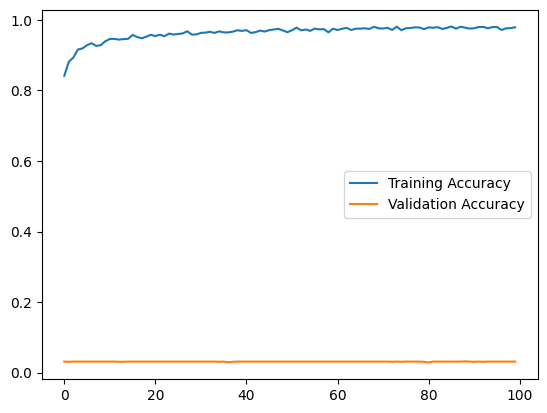

In [58]:
# Plot training history
plt.plot(model_history.history['accuracy'], label='Training Accuracy')
plt.plot(model_history.history['val_accuracy'], label='Validation Accuracy')
plt.legend()
plt.savefig(f"{working_dir}/res_net{epochs}_model_accuracy.jpg")
plt.show()

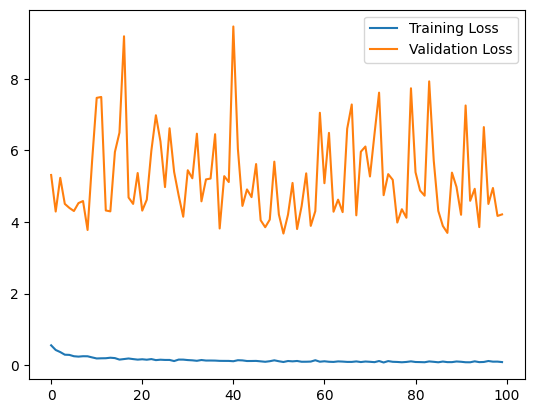

In [59]:
plt.plot(model_history.history['loss'], label='Training Loss')
plt.plot(model_history.history['val_loss'], label='Validation Loss')
plt.legend()
plt.savefig(f"{working_dir}/res_net{epochs}_model_loss.jpg")
plt.show()

In [60]:
blob = bucket.blob(f"{storageLocation+document_id}/val/training_plot{document_id}.jpg")
blob.upload_from_filename(f'{working_dir}/res_net{epochs}_model_accuracy.jpg')
blob.make_public()

In [63]:
blobloss = bucket.blob(f"{storageLocation+document_id}/val/training_plot_loss{document_id}.jpg")
blobloss.upload_from_filename(f'{working_dir}/res_net{epochs}_model_loss.jpg')
blobloss.make_public()

In [64]:
validationref=today_ref.collection('Val')

In [65]:
valhistory_ref=validationref.document('history')
valaccuracy_ref=validationref.document('accuracy_plot')

In [66]:
valhistory_ref.set(
    model_history.history
)

update_time {
  seconds: 1726134736
  nanos: 911458000
}

In [67]:
valaccuracy_ref.set({
    'accuracy_url':blob.public_url,
    'loss_url':blobloss.public_url
})

update_time {
  seconds: 1726134774
  nanos: 581545000
}

### Evaluation

In [68]:
test_loss, test_accuracy = ayushVision_ResNet50_Model.evaluate(test_ds_gen)
print(f'Test Accuracy: {test_accuracy*100:.2f}%')

100/100 ━━━━━━━━━━━━━━━━━━━━ 1383s 14s/step - accuracy: 0.0333 - loss: 4.1829
Test Accuracy: 3.13%


In [69]:
testref=today_ref.collection('Test')

In [70]:
test_accuracy_loss=testref.document('test_accuracy_lost')
test_accuracy_loss.set({
    'accuracy':test_accuracy,
    'loss':test_loss
})

update_time {
  seconds: 1726136176
  nanos: 214738000
}

In [71]:
modelref=today_ref.collection('Model')

In [72]:
ayushVision_ResNet50_Model.save(f'{working_dir}/res_net_{epochs}.h5',)

In [73]:
ayushVision_ResNet50_Model.save_weights(f'{working_dir}/res_net_{epochs}.weights.h5')

In [74]:
savemodel=modelref.document('model')

In [77]:
blob = bucket.blob(f"{storageLocation+document_id}/model/res_net_root_{epochs}.h5")
blob.upload_from_filename(f'{working_dir}/res_net_{epochs}.h5')
blob.make_public()
h5model=blob.public_url

In [78]:
savemodel.set({'model':h5model})

update_time {
  seconds: 1726136207
  nanos: 112090000
}

In [79]:
blob = bucket.blob(f"{storageLocation+document_id}/model/weights/res_net_weights_{epochs}.weights.h5")
blob.upload_from_filename(f'{working_dir}/res_net_{epochs}.weights.h5')
blob.make_public()
h5modelweights=blob.public_url

In [80]:
savemodel.update({
    'weights':h5modelweights
})

update_time {
  seconds: 1726136215
  nanos: 618881000
}

In [81]:
classnames=os.listdir(dataset_train_dir)

In [82]:
predictImagePath=os.path.join(dataset_dir,'predicts')

In [83]:
prdictsImages=list(map(lambda x:os.path.join(predictImagePath,x),os.listdir(predictImagePath)))

In [84]:
def load_and_preprocess_image(img_path, target_size=(224, 224)):
    img = image.load_img(img_path, target_size=target_size)  # Resize image to target size (224x224 by default)
    img_array = image.img_to_array(img)                      # Convert image to numpy array
    img_array = np.expand_dims(img_array, axis=0)            # Add batch dimension (required by the model)
    img_array /= 255.0                                       # Normalize the image to [0, 1] range
    return img_array

In [98]:
predictions = []
for img_path in prdictsImages:
    img_array = load_and_preprocess_image(img_path)
    preds = ayushVision_ResNet50_Model.predict(img_array)
    class_index = np.argmax(preds)
    confidence = preds[0, class_index]
    class_label = list(train_ds_gen.class_indices.keys())[class_index]
    predictions.append((img_path, class_label, confidence))

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
0


In [87]:
os.makedirs("/content/drive/MyDrive/AYUSHVISION/ready/2024_09_12_02_100/prdict/")

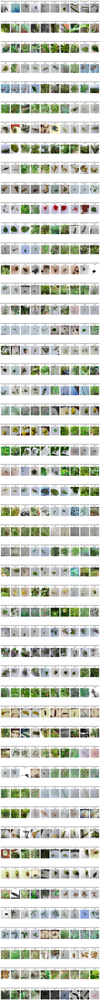

In [93]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Define a function to plot images
def plot_images(predictions, images_per_row=5):
    num_images = len(predictions)
    num_rows = (num_images + images_per_row - 1) // images_per_row

    fig, axes = plt.subplots(num_rows, images_per_row, figsize=(15, 3*num_rows))
    axes = axes.flatten()

    for img_idx, (img_path, class_label, confidence) in enumerate(predictions):
        img = mpimg.imread(img_path)
        axes[img_idx].imshow(img)
        axes[img_idx].set_title(f'{class_label}\n{confidence:.2f}')
        axes[img_idx].axis('off')

    # Hide any unused subplots
    for ax in axes[num_images:]:
        ax.axis('off')

    plt.tight_layout()
    plt.savefig(f'{working_dir}/prdict/predictImmage.png')
    plt.show()

# Plot images
plot_images(predictions, images_per_row=10)


In [96]:
blob = bucket.blob(f"{storageLocation+document_id}/predicts/res_net_prdicts_{epochs}.png")
blob.upload_from_filename(f'{working_dir}/prdict/predictImmage.png')
blob.make_public()
h5modelweights=blob.public_url

In [97]:
savemodel.update({'predicts':h5modelweights})

update_time {
  seconds: 1726137049
  nanos: 27987000
}

update_time {
  seconds: 1726137049
  nanos: 27987000
}